# Public Transport Coverage

Map Stations of the Public Transport System onto a Street Network and create an Isodistance Map to show the coverage of the Public Transport System


In [1]:
import common_options as co
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import networkx as nx
import osmnx as ox
import pandas as pd
from descartes import PolygonPatch
from shapely.geometry import Point, LineString, Polygon
from collections import defaultdict
import shapely.ops as so
import geopandas as gpd

%matplotlib inline
ox.config(log_console=True, use_cache=True)
ox.config(overpass_endpoint="http://127.0.0.1:12345/api") # use coverage of own design, comment out to use status quo
fname = 'stops_design' 
#fname = 'stops'
ox.__version__

'1.1.0'

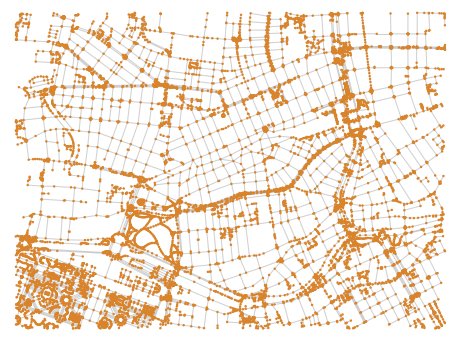

/home/lukas/venvs/osmnx/lib/python3.8/site-packages/osmnx/utils_geo.py:101: UserWarning: The `redistribute_vertices` function has been deprecated and will be removed in a future release. Use the more efficient `utils_geo.interpolate_points` instead.
  warnings.warn(msg)


In [2]:
from helpers import redistribute_graph

G = ox.graph_from_bbox(*co.bb_westbahnhofareal, clean_periphery=True, simplify=False, custom_filter=co.walking_filter_wbh, **co.graph_download_options)
fig, ax = ox.plot_graph(G, **co.graph_plot_nodes_options)

G_proj = ox.project_graph(G)

# to get fine grained results, long edges are split
# otherwise the dijkstra algorithm completely ignores all edges where the end-node cannot be reached, even if only by a minimal amount, not accurately mapping the reachable area 

G_proj = redistribute_graph(G_proj)

polygon = ox.utils_geo.bbox_to_poly(*co.bb_westbahnhofareal)

In [3]:
# 

def plot_isochrones(name, stops, trip_distances, iso_colors, infill):
    edge_buff=15
    node_buff=0

    isochrone_polys = defaultdict(list)

    starting_points = []
    for index, row in stops.iterrows(): # Looping over all points
        nearest = ox.nearest_nodes(G, [row.geometry.x], [row.geometry.y])[0]
        if nearest not in starting_points:
            starting_points.append(nearest)

    for center_node in starting_points:
        for trip_distance in sorted(trip_distances, reverse=True):
            subgraph = nx.ego_graph(G_proj, center_node, radius=trip_distance, distance='length', undirected=True)

            node_points = [Point((data['x'], data['y'])) for node, data in subgraph.nodes(data=True)]
            nodes_gdf = gpd.GeoDataFrame({'id': subgraph.nodes()}, geometry=node_points)
            nodes_gdf = nodes_gdf.set_index('id')

            edge_lines = []
            for n_fr, n_to in subgraph.edges():
                f = nodes_gdf.loc[n_fr].geometry
                t = nodes_gdf.loc[n_to].geometry
                edge_lookup = G_proj.get_edge_data(n_fr, n_to)[0].get('geometry',  LineString([f,t]))
                edge_lines.append(edge_lookup)

            n = nodes_gdf.buffer(node_buff).geometry
            e = gpd.GeoSeries(edge_lines).buffer(edge_buff).geometry
            all_gs = list(n) + list(e)
            new_iso = gpd.GeoSeries(all_gs).unary_union
            
            
            if infill:
                new_iso = Polygon(new_iso.exterior)
            isochrone_polys[trip_distance].append(new_iso)

    fig, ax = ox.plot_graph(G_proj, show=False, close=False, **co.graph_plot_options)
    for distance, fc in zip(list(reversed(trip_distances)), iso_colors):
        cascpoly = so.cascaded_union(isochrone_polys[distance])
        patch = PolygonPatch(cascpoly, fc=fc, ec='none', alpha=0.6, zorder=-1)
        ax.add_patch(patch)
    fig.savefig('figures/%s_%s_isodistance.svg' % (fname, name))
    fig.savefig('figures/%s_%s_isodistance.png' % (fname, name), bbox_inches='tight')
    plt.show()
    plt.close()

## Subway Stops only

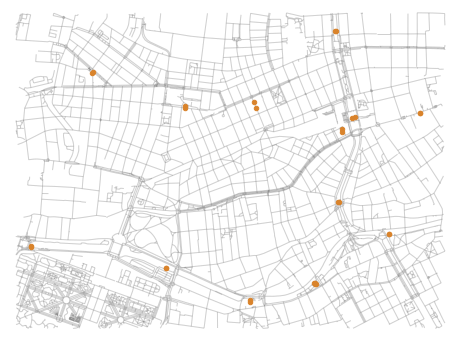

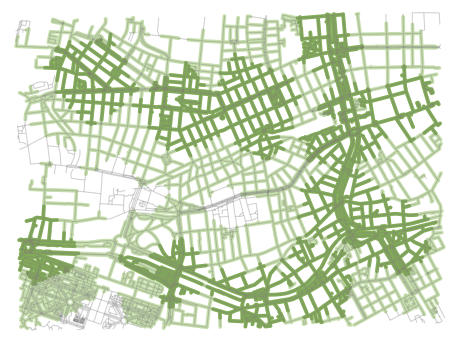

In [4]:
# only subway stops
stops = ox.geometries.geometries_from_polygon(polygon, {"public_transport": ["stop_position"]})
stops = stops[stops.subway.isin(['yes'])]
stops = stops[~stops.operator.isin(['ÖBB-Infrastruktur AG'])]

# describe background + stops, plot graph
fig, ax = ox.plot_graph(G, show=False, close=False, **co.graph_plot_options)
stops.plot(ax=ax, markersize = 20, color=co.col_orange , alpha=1, zorder=7)

fig.savefig('figures/%s_subway_points.svg' % fname)
fig.savefig('figures/%s_subway_points.png' % fname, bbox_inches='tight')

plot_isochrones('subway', stops, trip_distances=[400, 800], iso_colors=co.col_greens_2, infill=False)

## All Stops

/home/lukas/venvs/osmnx/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


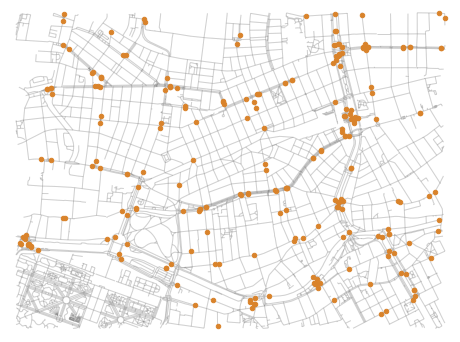

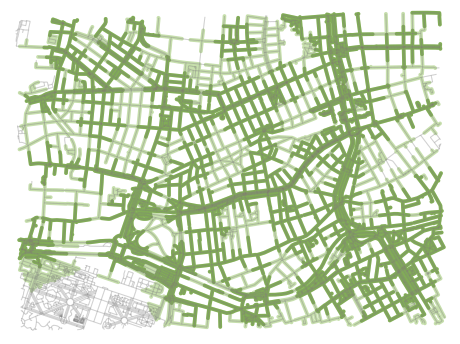

In [5]:
# all stops
stops = ox.geometries.geometries_from_polygon(polygon, {"public_transport": ["stop_position"]})
stops = stops[~stops.operator.isin(['ÖBB-Infrastruktur AG'])]

# describe background + stops, plot graph
fig, ax = ox.plot_graph(G, show=False, close=False, **co.graph_plot_options)
stops.plot(ax=ax, markersize = 20, color=co.col_orange , alpha=1, zorder=7)

fig.savefig('figures/%s_all_points.svg' % fname)
fig.savefig('figures/%s_all_points.png' % fname, bbox_inches='tight')

plot_isochrones('all', stops, trip_distances=[200, 400], iso_colors=co.col_greens_2, infill=False)